## Model (Backbone) Definition 

In [52]:
import torch.nn as nn
import torch.nn.functional as F

class ShallowFovea(nn.Module):
  def __init__(self, num_channels: int, out_channels: int):
    """Implements the Shallow Fovea Module as proposed by Chen et Lin
    
      Implements the biomimetic convolutional block introduced by the research paper:
      https://www.sciencedirect.com/science/article/abs/pii/S1051200424005815
      This block mimics the visual pathways in eagle eyes in order to detect small 
      objects in aerial imagery. The large kernel sizes of this module simulate the 
      wide field of view of an eagle.
      This module utilises branches (similar to the Inception model)
      Batch normalisation and activation functions are added to each conv layer 
      using a combination of functools.parital() and torch.Conv2dNormActivation.
    
      Args:
          num_channels: number of channels for the first layer
          out_channels: the number of channels each output feature map will have
    
      Returns:
          a torch tensor
    
      Raises:
          None
        """
    super().__init__()

    LeakyRelu_Inplace = partial(
        nn.LeakyReLU,
        negative_slope=0.1,
        inplace=True,
    )

    ConvBlock = partial(Conv2dNormActivation, activation_layer=LeakyRelu_Inplace)

    self.branch_1 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=1),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=7),
    )

    self.branch_2 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=1),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(1,7)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(7,1)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=7, dilation=3),
    )

    self.branch_3 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=1),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(3,1)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(1,3)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=7, dilation=3),
    )

    self.branch_4 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=out_channels, kernel_size=1),
    )

    self.downsampler = nn.LazyConv2d(out_channels=out_channels, kernel_size=3)


  def forward(self, x):
    branch_1 = self.branch_1(x)
    branch_2 = self.branch_2(x)
    branch_3 = self.branch_3(x)
    branch_4 = self.branch_4(x)

    upsampled_branch_1 = F.interpolate(
        branch_1,
        size=[branch_3.size(2), branch_3.size(3)],
        mode="bilinear",
    )
    del branch_1 #remove intermediate calculation from GPU RAM clear
    upsampled_branch_2 = F.interpolate(
        branch_2,
        size=[branch_3.size(2), branch_3.size(3)],
        mode="bilinear",
    )
    del branch_2 #remove intermediate calculation from GPU RAM clear

    branch_concat = torch.cat( (upsampled_branch_1,
                                upsampled_branch_2,
                                branch_3), dim=1 ) #concat on first dimension to allow for different number of channels
    del upsampled_branch_1, upsampled_branch_2, branch_3


    # prep ready for element wise multiplication
    downsampled_branch_concat = self.downsampler(branch_concat)
    del branch_concat #remove intermediate calculation from GPU RAM clear

    resized_branch_concat = F.interpolate(
        downsampled_branch_concat,
        size=[branch_4.size(2), branch_4.size(3)],
        mode="bilinear",
    )
    result = branch_4 * resized_branch_concat
    del branch_4, resized_branch_concat
    return result

In [53]:
class DeepFovea(nn.Module):
  def __init__(self, num_channels: int, out_channels: int):
    """Implements the Deep Fovea Module as proposed by Chen et Lin

      Implements the biomimetic convolutional block introduced by the research paper:
      https://www.sciencedirect.com/science/article/abs/pii/S1051200424005815
      This block mimics the visual pathways in eagle eyes in order to detect small 
      objects in aerial imagery. The small kernel sizes of this module preserve the 
      pixel data of small objects - effectively simulating the magnification mechanism 
      in eagle eyes which allows the to spot small prey during flight.
      This module utilises branches (similar to the Inception model)
      Batch normalisation and activation functions are added to each conv layer 
      using a combination of functools.parital() and torch.Conv2dNormActivation.

      Args:
          num_channels: number of channels for the first layer
          out_channels: the number of channels each output feature map will have

      Returns:
          a torch tensor

      Raises:
          None
      """
    super().__init__()

    LeakyRelu_Inplace = partial(
        nn.LeakyReLU,
        negative_slope=0.1,
        inplace=True,
    )

    ConvBlock = partial(Conv2dNormActivation, activation_layer=LeakyRelu_Inplace)

    self.branch_1 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=1),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=3),
    )

    self.branch_2 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=1),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(1,3)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(3,1)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=3, dilation=3),
    )

    self.branch_3 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=1),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(3,1)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=(1,3)),
        ConvBlock(in_channels=num_channels, out_channels=num_channels, kernel_size=3, dilation=3),
    )

    self.branch_4 = nn.Sequential(
        ConvBlock(in_channels=num_channels, out_channels=out_channels, kernel_size=1),
    )

    self.downsampler = nn.LazyConv2d(out_channels=out_channels, kernel_size=3)


  def forward(self, x):
    branch_1 = self.branch_1(x)
    branch_2 = self.branch_2(x)
    branch_3 = self.branch_3(x)
    branch_4 = self.branch_4(x)

    upsampled_branch_1 = F.interpolate(
        branch_1,
        size=[branch_3.size(2), branch_3.size(3)],
        mode="bilinear",
    )
    del branch_1 #remove intermediate calculation from GPU RAM clear
    upsampled_branch_2 = F.interpolate(
        branch_2,
        size=[branch_3.size(2), branch_3.size(3)],
        mode="bilinear",
    )
    del branch_2 #remove intermediate calculation from GPU RAM clear

    branch_concat = torch.cat( (upsampled_branch_1,
                                upsampled_branch_2,
                                branch_3), dim=1 ) #concat on first dimension to allow for different number of channels
    del upsampled_branch_1, upsampled_branch_2, branch_3

    # prep ready for element wise multiplication
    downsampled_branch_concat = self.downsampler(branch_concat)
    del branch_concat #remove intermediate calculation from GPU RAM clear

    resized_branch_concat = F.interpolate(
        downsampled_branch_concat,
        size=[branch_4.size(2), branch_4.size(3)],
        mode="bilinear",
    )

    result = branch_4 * resized_branch_concat
    del branch_4, resized_branch_concat
    return result

In [54]:
#SAM
# 1. channel pool: input tensor (cxhxw) is decomposed to (2xhxw)
# the two channels represent max pooling and average pooling across all channels

# 2. conv layer which outputs a 1 channel feature map (1xhxw)
# 3. batch normalisation layer to normalise and scale output of conv layer

# 4. option to use relu activation function after conv layer

# 5. output is passed to sigmoid activation fn

# 6. element-wise multiplication of spatial attention mask and all feature maps in input tensor
class SpatialAttention(nn.Module):
  def __init__(self, kernel_size:int = 7,
               conv_bias: bool = False,
               has_batch_norm: bool = True,
               has_relu: bool = True) -> None:
    super().__init__()

    self.conv = nn.Conv2d(2, 1, kernel_size=kernel_size, stride=1, padding=(kernel_size-1) // 2, bias=conv_bias)
    self.bn = nn.BatchNorm2d(1) if has_batch_norm else None
    self.relu = nn.ReLU() if has_relu else None

    self.sigmoid = nn.Sigmoid()

  def forward(self, x):
    raw_input = x

    # compress input
    x = torch.cat( (torch.max(x,1)[0].unsqueeze(1), torch.mean(x,1).unsqueeze(1)), dim=1 )

    # conv layer
    x = self.conv(x)
    if self.bn is not None:
      x = self.bn(x)
    if self.relu is not None:
      x = self.relu(x)

    x = self.sigmoid(x)

    output = raw_input * x
    return output

In [55]:
class ChannelAttention(nn.Module):
  def __init__(self, in_channels: int, reduction_ratio: int =16, ):
    super().__init__()

    # according to the CBAM research paper
    # use a shared MLP for attention inference to save parameters, as both of aggregated channel
    # features lie in the same semantic embedding space.
    self.mlp = nn.Sequential(
        # input layer
        nn.Linear(in_channels, in_channels // reduction_ratio),
        nn.ReLU(),
        # hidden layer
        nn.LazyLinear(in_channels // reduction_ratio),
        nn.ReLU(), #use relu within the hidden layers to mitigate risk of vanishing gradient
        nn.LazyLinear(in_channels // reduction_ratio),
        nn.ReLU(),
        # output layer
        nn.Linear(in_channels // reduction_ratio, in_channels)
    )
    self.sigmoid = nn.Sigmoid()

  def forward(self, x):
    raw_input = x
    # Maxpool input
    max_pool = F.max_pool2d( x,
                            kernel_size=(x.size(2), x.size(3)),
                            stride=(x.size(2), x.size(3)))
    # feed through MLP
    max_pool = max_pool.view(max_pool.size(0), -1) #flatten ready for linear layers
    channel_att_max = self.mlp( max_pool )

    # AvgPool input
    avg_pool = F.avg_pool2d( x,
                            kernel_size=(x.size(2), x.size(3)),
                             stride=(x.size(2), x.size(3)))
    # feed through MLP
    avg_pool = avg_pool.view(avg_pool.size(0), -1) #flatten ready for linear layers
    channel_att_avg = self.mlp( avg_pool )

    # add MLP results
    attention_mask = channel_att_max + channel_att_avg

    # feed through sigmoid
    attention_mask = self.sigmoid(attention_mask)
    # unsqueeze to make dimension of attention mask compatible with raw input
    # fixes RuntimeError: The size of tensor a (136) must match the size of tensor b (32) at non-singleton dimension 3
    attention_mask = attention_mask.unsqueeze(-1).unsqueeze(-1)

    output = raw_input * attention_mask
    return output

In [56]:
class CBAM(nn.Module):
  def __init__(self,
               in_channels:int,
               reduction_ratio: int = 16,
               is_channel_att: bool = True,
               is_spatial_att: bool = True) -> None:
    super().__init__()
    self.channel_attention = ChannelAttention(in_channels, reduction_ratio) if is_channel_att else None
    self.spatial_attention = SpatialAttention() if is_spatial_att else None

  def forward(self, x):
    if self.channel_attention is not None:
      x = self.channel_attention(x)
    if self.spatial_attention is not None:
      x = self.spatial_attention(x)

    return x

In [57]:
class ScaledCBAM(nn.Module):
  def __init__(self, in_channels, scaling_parameter):
    super().__init__()
    self.cbam = CBAM(in_channels)
    self.scale = scaling_parameter

  def forward(self, x):
    return self.scale * self.cbam(x)

In [58]:
# the code in this cell is adapted from Kapil Sachdeva:
# https://www.youtube.com/watch?v=FKsgO0U7CUw&list=PLjRC2jqp3e7QNio7NJXRh_gvAdLV6_aZC&index=132
# the code has been modified so that it accomodates all 4 layers (feature maps) of the ResNetCBAM backbone (defined above)
# code has also been modified to delete intermediate calculations as a form of memory management
import torch
from functools import partial
from torchvision.ops.misc import Conv2dNormActivation

class FPN(nn.Module):
  def __init__(self, in_channels: list[int], out_channels: int) -> list:
    """Implements top down feature pyramid network

      Sets the model to eval mode and runs the model to get inferences.
      Non-maximum suppression is applied before mAPs are calculated.
      mAP50 and mAP50-95 are printed for convenience
      Model predictions are returned so that they can be visualised by
      a follow up call to visualise_predictions()

      Args:
          in_channels: list of integers representing the number of channels for each feature map:
                        list should follow the order low level -> high level features
          out_channels: the number of channels each output feature map will have

      Returns:
          A list containing the resulting feature maps (ordered high level -> low level)

      Raises:
          None
      """
    super().__init__()

    LeakyRelu_Inplace = partial(
        nn.LeakyReLU,
        negative_slope=0.1,
        inplace=True,
    )

    ConvBlock = partial(Conv2dNormActivation, activation_layer=LeakyRelu_Inplace)

    self.output_channels = out_channels
    if in_channels[3] != out_channels:
      self.hl_channel_reducer = ConvBlock(
          in_channels=in_channels[3],
          out_channels=out_channels,
          kernel_size=1,
      )

    self.ml_1_channel_reducer = ConvBlock(
        in_channels=in_channels[2],
        out_channels=out_channels,
        kernel_size=1,
    )

    self.ml_2_channel_reducer = ConvBlock(
        in_channels=in_channels[1],
        out_channels=out_channels,
        kernel_size=1,
    )

    self.ll_channel_reducer = ConvBlock(
        in_channels=in_channels[0],
        out_channels=out_channels,
        kernel_size=1,
    )

    self.ml_1_smoother = ConvBlock(
        in_channels=out_channels,
        out_channels=out_channels,
    )

    self.ml_2_smoother = ConvBlock(
        in_channels=out_channels,
        out_channels=out_channels,
    )

    self.ll_smoother = ConvBlock(
        in_channels=out_channels,
        out_channels=out_channels,
    )

  def forward(self,
              hl_features:torch.Tensor,
              ml_1_features:torch.Tensor,
              ml_2_features:torch.Tensor,
              ll_features:torch.Tensor):

    if hl_features.size()[1] != self.output_channels:
      hl_channel_r = self.hl_channel_reducer(hl_features)
      del hl_features

    ml_channel_1_r = self.ml_1_channel_reducer(ml_1_features) #Given groups=1, weight of size [256, 128, 1, 1], expected input[16, 64, 50, 68] to have 128 channels, but got 64 channels instead
    del ml_1_features
    ml_channel_2_r = self.ml_2_channel_reducer(ml_2_features)
    del ml_2_features
    ll_channel_r = self.ll_channel_reducer(ll_features)
    del ll_features

    # addition 1
    if hl_features.size()[1] != self.output_channels:
      upsample_hl = F.interpolate(
          hl_channel_r,
          size=[ml_channel_1_r.size(2), ml_channel_1_r.size(3)],
          mode="nearest",
      )
    else:
      upsample_hl = F.interpolate(
          hl_features,
          size=[ml_channel_1_r.size(2), ml_channel_1_r.size(3)],
          mode="nearest",
      )

    fused_hl_ml_1 = upsample_hl + ml_channel_1_r
    smoothed_ml_1_features = self.ml_1_smoother(fused_hl_ml_1)
    # memory management
    del ml_channel_1_r, fused_hl_ml_1, upsample_hl

    # addition 2
    upsample_ml_1 = F.interpolate(
        smoothed_ml_1_features,
        size=[ml_channel_2_r.size(2), ml_channel_2_r.size(3)],
        mode="nearest",
    )
    fused_ml_2_ml_1 = upsample_ml_1 + ml_channel_2_r
    smoothed_ml_2_features = self.ml_2_smoother(fused_ml_2_ml_1)
    # memory management
    del upsample_ml_1, ml_channel_2_r, fused_ml_2_ml_1

    # addition 3
    upsample_ml_2 = F.interpolate(
        smoothed_ml_2_features,
        size=[ll_channel_r.size(2), ll_channel_r.size(3)],
        mode="nearest",
    )
    fused_ml_ll = upsample_ml_2 + ll_channel_r
    smoothed_ll_features = self.ll_smoother(fused_ml_ll)
    # memory management
    del upsample_ml_2, ll_channel_r, fused_ml_ll

    out = [smoothed_ll_features, 
           smoothed_ml_1_features,
           smoothed_ml_2_features,
           hl_features if hl_features.size()[1] == self.output_channels else hl_channel_r,
           ]
    return out

In [59]:
from collections import OrderedDict

class FoveaBackbone(nn.Module):
  def __init__(self, in_channels: int):
    """Integrates ShallowFovea and DeepFovea modules, CBAM attention and an FPN into 
        a backbone ready to be integrated into Faster R-CNN

      Each block of (ShallowFovea, DualFovea) is followed by a CBAM attention mechanism 
      (Convolutional Block Attention Module). The feature maps produced at each stage 
      in the network are then fed through a top-down FPN (Feature Pyramid Network)
      which infuses the lower level features with the semantic information extract 
      from deeper convolutional layers.

      Args:
          in_channels: the number of channels to be passed to the first block 

      Returns:
          a list of feature maps (ready to be passed to the Faster R-CNN Region 
          Proposal Network)

      Raises:
          None
      """
    super().__init__()

    LeakyRelu_Inplace = partial(
        nn.LeakyReLU,
        negative_slope=0.1,
        inplace=True,
    )

    ConvBlock = partial(Conv2dNormActivation, activation_layer=LeakyRelu_Inplace)

    #stride not mention in EVM paper but needed for memory management
    self.block_1 = nn.Sequential(
        ConvBlock(in_channels=in_channels, out_channels=32, kernel_size=3, stride=2),
        nn.MaxPool2d(kernel_size=2)
    )
    self.shallow_fovea_1 = ShallowFovea(num_channels=32, out_channels=64)
    self.deep_fovea_1 = DeepFovea(num_channels=32, out_channels=64)
    self.shallow_fovea_2 = ShallowFovea(num_channels=64, out_channels=128)
    self.deep_fovea_2 = DeepFovea(num_channels=64, out_channels=128)

    self.shallow_fovea_3 = ShallowFovea(num_channels=128, out_channels=256)
    self.deep_fovea_3 = DeepFovea(num_channels=128, out_channels=256)

    self.shallow_fovea_4 = ShallowFovea(num_channels=256, out_channels=512)
    self.deep_fovea_4 = DeepFovea(num_channels=256, out_channels=512)

    self.max_pooler = nn.MaxPool2d(kernel_size=2)
    self.fpn = FPN(in_channels=[64, 128, 256, 512], out_channels=512)
    # self.fpn = FPNDynamicTextureAttention(ll_feat_input_size=64, hl_feat_input_size=512)

    self.cbam_scaler_1 = nn.Parameter(torch.zeros(1))
    self.cbam_1 = ScaledCBAM(in_channels=64, scaling_parameter=self.cbam_scaler_1)
    self.cbam_scaler_2 = nn.Parameter(torch.zeros(1))
    self.cbam_2 = ScaledCBAM(in_channels=128, scaling_parameter=self.cbam_scaler_2)
    self.cbam_scaler_3 = nn.Parameter(torch.zeros(1))
    self.cbam_3 = ScaledCBAM(in_channels=256, scaling_parameter=self.cbam_scaler_3)
    self.cbam_scaler_4 = nn.Parameter(torch.zeros(1))
    self.cbam_4 = ScaledCBAM(in_channels=512, scaling_parameter=self.cbam_scaler_4)

  def forward(self, x):
    x = self.block_1(x)

    shallow_feats_1 = self.shallow_fovea_1(x)
    deep_feats_1 = self.deep_fovea_1(x)
    stage_1_results = shallow_feats_1 + deep_feats_1
    stage_1_results_pooled = self.max_pooler(stage_1_results) #reduce computational load for successive layers
    stage_1_results_w_cbam = self.cbam_1(stage_1_results)
    # memory management
    del shallow_feats_1, deep_feats_1, stage_1_results

    shallow_feats_2 = self.shallow_fovea_2(stage_1_results_pooled)
    deep_feats_2 = self.deep_fovea_2(stage_1_results_pooled)
    stage_2_results = shallow_feats_2 + deep_feats_2
    stage_2_results_pooled = self.max_pooler(stage_2_results) #reduce computational load for successive layers
    stage_2_results_w_cbam = self.cbam_2(stage_2_results)
    # memory management
    del shallow_feats_2, deep_feats_2, stage_2_results, stage_1_results_pooled,

    shallow_feats_3 = self.shallow_fovea_3(stage_2_results_pooled)
    deep_feats_3 = self.deep_fovea_3(stage_2_results_pooled)
    stage_3_results = shallow_feats_3 + deep_feats_3
    stage_3_results_pooled = self.max_pooler(stage_3_results) #reduce computational load for successive layers
    stage_3_results_w_cbam = self.cbam_3(stage_3_results)
    # memory management
    del shallow_feats_3, deep_feats_3, stage_3_results, stage_2_results_pooled,

    shallow_feats_4 = self.shallow_fovea_4(stage_3_results_pooled)
    deep_feats_4 = self.deep_fovea_4(stage_3_results_pooled)
    stage_4_results = shallow_feats_4 + deep_feats_4
    stage_4_results_w_cbam = self.cbam_4(stage_4_results)
    # memory management
    del shallow_feats_4, deep_feats_4, stage_4_results, stage_3_results_pooled,

    feat_maps = self.fpn(hl_features = stage_4_results_w_cbam,
                        ml_1_features= stage_3_results_w_cbam,
                        ml_2_features = stage_2_results_w_cbam,
                        ll_features= stage_1_results_w_cbam)

    return OrderedDict([(k, v) for k, v in zip(["ll_feats",
                                                "ml_1_feats",
                                                "ml_2_feats",
                                                "hl_feats"], feat_maps)])

In [60]:
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

backbone = FoveaBackbone(3)
backbone.out_channels = 512

# LOAD BEST HYPERPARAMETERS 
# **************************

anchor_sizes = ((8,), (32,), (64,), (128,))
aspect_ratios = (((0.5,), (1.0,), (2.0,)),) * len(anchor_sizes)
anchor_generator = AnchorGenerator(anchor_sizes, aspect_ratios)

roi_pooler = torchvision.ops.MultiScaleRoIAlign(
    # specify the feature maps to be used by the region proposal network
    featmap_names=["ll_feats",
                    "ml_1_feats",
                    "ml_2_feats",
                    "hl_feats"],
    output_size=7,
    sampling_ratio=2
)

# initialise the model with the custom backbone
model = FasterRCNN(
    backbone=backbone, #integration of custom backbone into the model
    num_classes=3,
    rpn_anchor_generator=anchor_generator,
    box_roi_pool=roi_pooler
)
num_classes=3 #2 classes +1 to account for background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

## Load Trained Weights:

In [61]:
# Model weights can be downloaded at the following link 
# The .pth file exceeds the Github 100MB limit
# https://drive.google.com/file/d/1-doWl6zGmP-aPTNoFe-_q2i1w0J16eWF/view?usp=drive_link
PATH = './trained_model_weights/inference_weights.pth'
if torch.cuda.is_available():
    model.load_state_dict(torch.load(PATH, weights_only=True))
    device = torch.device("cuda")
    model.to(device)
else:
    model.load_state_dict(torch.load(PATH, weights_only=True, map_location=torch.device('cpu')))
    
model.eval() #set to eval ready for inferences

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): FoveaBackbone(
    (block_1): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.1, inplace=True)
      )
      (1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (shallow_fovea_1): ShallowFovea(
      (branch_1): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): LeakyReLU(negative_slope=0.1, inplace=True)
        )
        (1): Conv2dNormActivation(
   

## Sample Inferences

In [62]:
#load images that have not been seen by the model
import os
import cv2
from torchvision import transforms

sample_images = []
# transform images to tensors ready for inference 
for img in os.listdir('./sample_images'):
    img_read = cv2.imread('./sample_images' + '/' + img)
    image_transform = transforms.ToTensor()  #cv library reads as a numpy array, needs to be a pytorch tensor to be compatible
    formatted_img = image_transform(img_read)
    if torch.cuda.is_available():
        formatted_img.to(device)
    sample_images.append(formatted_img)

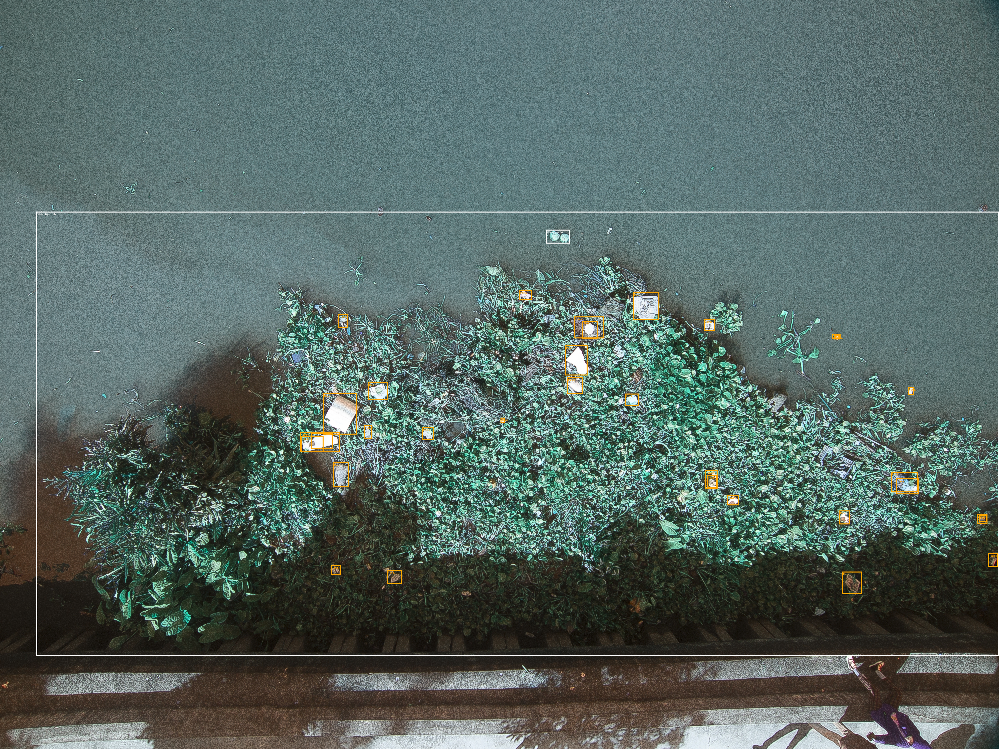

In [63]:
from torchvision.utils import draw_bounding_boxes

img_index = 1

with torch.no_grad():
    preds = model([sample_images[img_index]])
    
boxes = preds[0]['boxes']
labels = preds[0]['labels']
scores = preds[0]['scores']

# filter out predictions with confidence score less than threshold
indices_above_threshold = torch.argwhere(scores > 0.4)
indices_above_threshold = indices_above_threshold.tolist()
indices_above_threshold = [element for innerList in indices_above_threshold for element in innerList]
filtered_boxes = torch.index_select(boxes, 0, torch.LongTensor(indices_above_threshold))
filtered_labels = torch.index_select(labels, 0, torch.LongTensor(indices_above_threshold))
# convert labels to list type as required by draw_bounding_boxes
filtered_labels = filtered_labels.tolist() 
label_mappings = {'1': 'Plastic', '2': 'Water Hyacinth'}
formatted_labels = [label_mappings[str(i)] for i in filtered_labels]
color_mappings = {'Plastic': '#FFA500', 'Water Hyacinth': 'white'}
box_colors = [color_mappings[i] for i in formatted_labels]



model_inference = draw_bounding_boxes(image = sample_images[img_index],
                                       boxes = filtered_boxes,
                                       labels = formatted_labels,
                                       colors=box_colors,
                                        width=4,
                                        )
# transform this image to PIL image 
img = torchvision.transforms.ToPILImage()(model_inference) 
display(img)